# Obtaining Data

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt

headers = ['cast_count', 'bottle_count', 'line_and_station', 'depth_id', 'depth', 'temperature', 'salinity']
columns_to_load = headers[:7]

ocean_data = pd.read_csv('', on_bad_lines='skip', skiprows=1, names=headers, usecols=columns_to_load)

# Dropping unnecessary columns
ocean_data.drop(columns=['cast_count', 'bottle_count', 'line_and_station', 'depth_id', 'depth'], inplace=True)

ocean_data.head()


FileNotFoundError: [Errno 2] No such file or directory: 'bottle.csv'

# Missing Data

In [ ]:
print(f"The dataset has {ocean_data.shape[0]} rows")

The dataset has 864863 rows


In [ ]:
ocean_data.isna().sum()

temperature    10963
salinity       47354
dtype: int64

# Cleaning data

We have 10963 rows that are missing the temperature value, and 47354 rows that are missing their salinity value. The rows that are missing both values won't show up on our model. However, the data points that are missing only one of these 2 values might affect our model, therefore we will idenitfy, and remove them.

In [ ]:
# Filtering rows with missing temp but not salinity
temp_not_salinity = ocean_data[ocean_data['temperature'].isna() & ~ocean_data['salinity'].isna()]

# Filtering rows with missing salinity but not temp
salinity_not_temp = ocean_data[ocean_data['salinity'].isna() & ~ocean_data['temperature'].isna()]

# Combining the 2 lists of undesired values
rows_to_remove = pd.concat([temp_not_salinity, salinity_not_temp])

# Dropping undesired rows
ocean_data.drop(index=rows_to_remove.index, inplace=True)

print(len(ocean_data))

821948


We will also remove all rows with NaN values, since these will affect our model.

In [ ]:
ocean_data.dropna(inplace=True)

After removing so many rows, we need to reset our index to not have any problems

In [ ]:
ocean_data.reset_index(drop=True, inplace=True)

# Data Wrangling
- Standarization/Normalization?:
One could consider standarizing/normalizing the data. However, as you will see below, the difference in magnitude between salinity and temperature is not significant. Even tough they have different units, they're ranges are similar. While temperature ranges from 1-31, salinity ranges from 28-37. Therefore, one variable will not outweight the other, and therefore, we don't need to standarize ot normalize them. Additionally, since linear regression (which is the model we're going to use) is based on correlation, the linear transformations we perform will not affect our model significantly.

- Pivot tables / Melting
Since our data is already in an optimal format for analysis, we don't really need to use either pivot tables nor melting.


In [ ]:
ocean_data.describe()

,temperature,salinity
count,814247.000000,814247.000000
mean,10.860287,33.841337
std,4.224930,0.461636
min,1.440000,28.431000
25%,7.750000,33.489000
50%,10.110000,33.866000
75%,13.930000,34.197000
max,31.140000,37.034000


# Dividing data into training and testing datasets

In [ ]:
random_indexes = np.random.permutation(len(ocean_data))

training_ocean_dataset = ocean_data.loc[random_indexes[:int(len(ocean_data)*0.8)]] #random_values[:120]
testing_ocean_dataset = ocean_data.loc[random_indexes[int(len(ocean_data)*0.8):]] #random_values[120:]

# Graphing

In [ ]:
ocean_data.corr()

,temperature,salinity
temperature,1.000000,-0.505266
salinity,-0.505266,1.000000


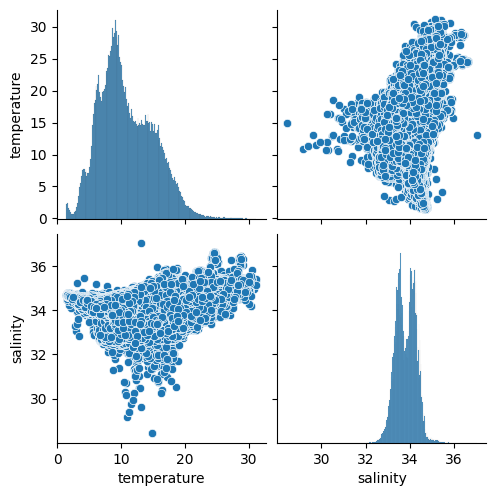

In [ ]:
sns.pairplot(training_ocean_dataset)

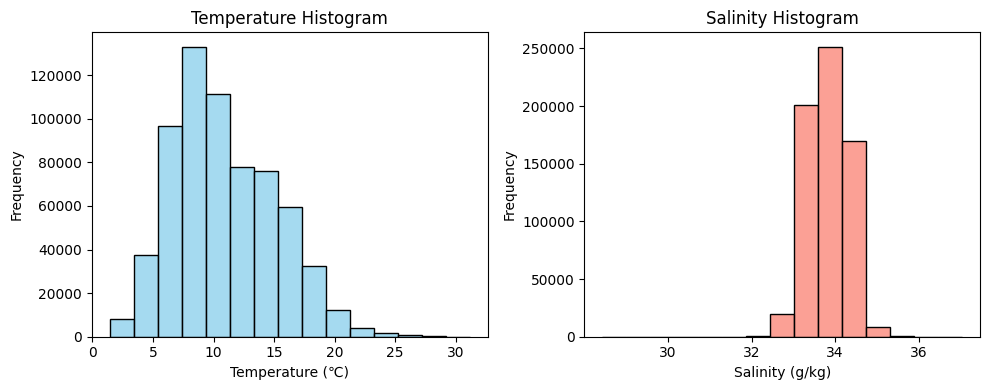

In [ ]:
plt.figure(figsize=(10, 4)) 

plt.subplot(1, 2, 1)
sns.histplot(training_ocean_dataset['temperature'], bins=15, color='skyblue')
plt.xlabel('Temperature (\u2103)')
plt.ylabel('Frequency')
plt.title('Temperature Histogram')

plt.subplot(1, 2, 2) 
sns.histplot(training_ocean_dataset['salinity'], bins=15, color='salmon')
plt.xlabel('Salinity (g/kg)')
plt.ylabel('Frequency')
plt.title('Salinity Histogram')

plt.tight_layout() 
plt.show()


In [ ]:
fig = px.scatter(training_ocean_dataset, x='temperature', y='salinity')

fig.update_layout(
    xaxis_title='Temperature (\u2103)',
    yaxis_title='Salinity (g/kg)',
    title='Ocean Temperature vs Salinity'
)
fig.show()

# Discuss a few questions we can answer using this data and choose one
- Can we predict the salinity level of the water from it's temperature?
- Is there a trend in temperature and salinity levels in the last 70 years?
- Are temperature and salinity increasing, decreasing, or remaining stable over time?
- Are there any significant fluctuations temperature and salinity trends?
- Are there signs of climate change reflected in temperature and salinity data?

In [ ]:
def lin_reg(x, y, x_label, y_label):

    X_bar = x - np.mean(x)
    Y_bar = y - np.mean(y)

    a = X_bar.dot(Y_bar) / X_bar.dot(X_bar)
    b = np.mean(y) - a * np.mean(x)

    print(f"Linear Regression Model ({x_label} and {y_label}):  y = {a}x + {b}")

    return (a,b)

b0_b1 = lin_reg(training_ocean_dataset['temperature'], training_ocean_dataset['salinity'], 'temperature', 'salinity')


Linear Regression Model (temperature and salinity):  y = -0.05504897339687428x + 34.43934280133775


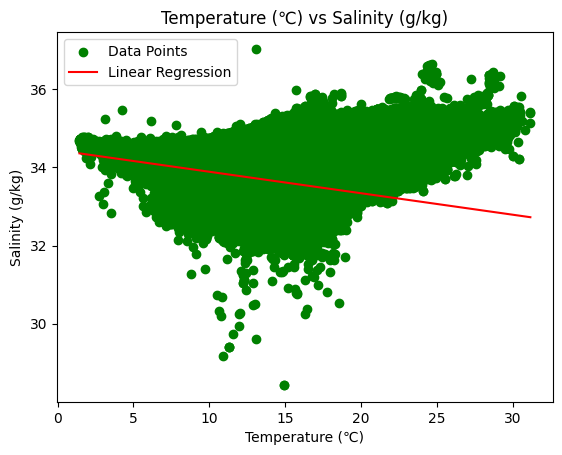

In [ ]:
def lin_graph(X, Y, b0, b1, label_x, label_y):
    x = np.linspace(X.min(), X.max(), 100)

    y = b0 + b1 * x

    plt.scatter(X, Y, color='green', label='Data Points')

    plt.plot(x, y, color='red', label='Linear Regression')

    plt.xlabel(label_x)
    plt.ylabel(label_y)
    plt.title(f"{label_x} vs {label_y}")
    plt.legend()

    plt.show()

lin_graph(training_ocean_dataset['temperature'], training_ocean_dataset['salinity'], b0_b1[1], b0_b1[0], 'Temperature (\u2103)', 'Salinity (g/kg)')

# Making predictions using model

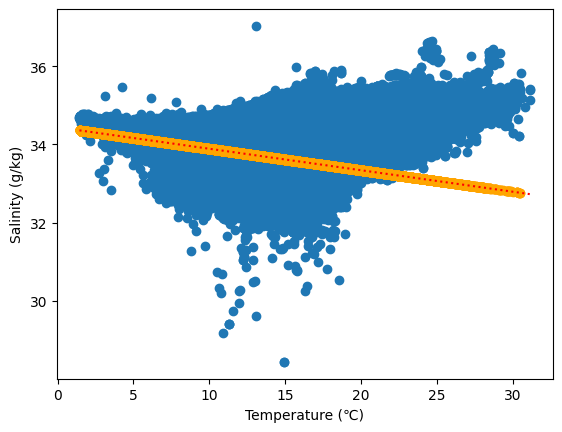

In [ ]:
x_test = testing_ocean_dataset['temperature']
y_true = testing_ocean_dataset.drop(columns=['temperature'])

y_pred = b0_b1[1] + b0_b1[0] * x_test

x_line = np.linspace(training_ocean_dataset['temperature'].min(), training_ocean_dataset['temperature'].max(), 100)

y_line = b0_b1[1] + b0_b1[0] * x_line

plt.scatter(training_ocean_dataset['temperature'], training_ocean_dataset['salinity'])
plt.plot(x_line, y_line, c='red', linestyle=':')
plt.scatter(x_test, y_pred, c='orange')
plt.xlabel('Temperature (\u2103)')
plt.ylabel('Salinity (g/kg)')

plt.show()

# Model Evaluation

In [ ]:
import math

def MAE(n, predicted, actual):
    constant = 1/n
    sum = 0
    for pred, act in zip(predicted, actual):
        sum += abs(act - pred)
    return constant * sum

def MSE(n, predicted, actual):
    constant = 1/n
    sum = 0
    for pred, act in zip(predicted, actual):
        sum += (act - pred) ** 2
    return constant * sum

def SSE(predicted, actual):
    sum = 0
    for pred, act in zip(predicted, actual):
        sum += (act - pred) ** 2
    return sum

def RMSE(n, predicted, actual):
    constant = 1/n
    sum = 0
    for pred, act in zip(predicted, actual):
        sum += (act - pred) ** 2
    return math.sqrt(constant * sum)

def RMSLE(n, predicted, actual):
    constant = 1/n
    sum = 0
    for pred, act in zip(predicted, actual):
        sum += (math.log((1 + act) / (1 + pred))) ** 2
    return math.sqrt(constant * sum)

n = len(y_pred.values)
mae = MAE(n, y_pred.values, y_true.values)
mse = MSE(n, y_pred.values, y_true.values)
sse = SSE(y_pred.values, y_true.values)
rmse = RMSE(n, y_pred.values, y_true.values)
rmsle = RMSLE(n, y_pred.values, y_true.values)

print(f"""The MAE is: {mae}
The MSE is: {mse}
The SSE is: {sse}
The RMSE is: {rmse}
The RMSLE is: {rmsle}
""")


/var/folders/j1/2z985v_1111_xbnq1c713bxc0000gn/T/ipykernel_90787/2527783435.py:28: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

/var/folders/j1/2z985v_1111_xbnq1c713bxc0000gn/T/ipykernel_90787/2527783435.py:34: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)



The MAE is: [0.27941063]
The MSE is: [0.15845769]
The SSE is: [25804.83439604]
The RMSE is: 0.39806744079126477
The RMSLE is: 0.01143897836455649

